!pip install -U flwr["simulation"]


In [ ]:
!pip install -U flwr["simulation"]


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 364.7/364.7 kB 3.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 294.6/294.6 kB 4.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 16.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.0/46.0 kB 2.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 65.1/65.1 MB 6.7 MB/s eta 0:00:00
  Attempting uninstall: typer
    Found existing installation: typer 0.12.3
    Uninstalling typer-0.12.3:
      Successfully uninstalled typer-0.12.3
  Attempting uninstall: protobuf
    Found existing installation: protobuf 3.20.3
    Uninstalling protobuf-3.20.3:
      Successfully uninstalled protobuf-3.20.3
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tensorflow-metadata 1.15.0 requires protobuf<4.21,>=3.20.3; python_version < "3.11", but you have protobuf 4

In [ ]:
!pip install -q flwr_datasets["vision"]

In [ ]:
pip install flwr-datasets

In [ ]:
import flwr as fl
from collections import OrderedDict
from sklearn.model_selection import train_test_split
from flwr.simulation.ray_transport.utils import enable_tf_gpu_growth

from typing import List, Tuple,Dict

import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import tensorflow as tf
from flwr.common import Metrics
from datasets import Dataset
from flwr_datasets import FederatedDataset

ModuleNotFoundError: No module named 'flwr'

In [ ]:
from google.colab import files
files.upload()

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


Saving WSN-DS.csv to WSN-DS.csv


{'WSN-DS.csv': b' id, Time, Is_CH, who CH, Dist_To_CH, ADV_S, ADV_R, JOIN_S, JOIN_R, SCH_S, SCH_R,Rank, DATA_S, DATA_R, Data_Sent_To_BS, dist_CH_To_BS, send_code ,Expaned Energy,Attack type\r\n101000,50,1,101000,0,1,0,0,25,1,0,0,0,1200,48,130.08535,0,2.4694,Normal\r\n101001,50,0,101044,75.32345,0,4,1,0,0,1,2,38,0,0,0,4,0.06957,Normal\r\n101002,50,0,101010,46.95453,0,4,1,0,0,1,19,41,0,0,0,3,0.06898,Normal\r\n101003,50,0,101044,64.85231,0,4,1,0,0,1,16,38,0,0,0,4,0.06673,Normal\r\n101004,50,0,101010,4.83341,0,4,1,0,0,1,25,41,0,0,0,3,0.06534,Normal\r\n101005,50,0,101010,31.91198,0,4,1,0,0,1,18,41,0,0,0,3,0.06717,Normal\r\n101006,50,0,101044,24.34167,0,4,1,0,0,1,5,38,0,0,0,4,0.06214,Normal\r\n101007,50,0,101010,26.75033,0,4,1,0,0,1,21,41,0,0,0,3,0.06662,Normal\r\n101008,50,0,101044,63.66485,0,4,1,0,0,1,17,38,0,0,0,4,0.06649,Normal\r\n101009,50,0,101000,32.90217,0,4,1,0,0,1,12,48,0,0,0,1,0.07903,Normal\r\n101010,50,1,101010,0,1,0,0,30,1,0,0,0,1230,41,108.77162,0,2.3611,Normal\r\n101011,50,0,

In [ ]:
from datasets import load_dataset
from flwr_datasets import partitioner

data_files = "WSN-DS.csv"

In [ ]:
df = pd.read_csv("WSN-DS.csv")
original_df=pd.read_csv("WSN-DS.csv")

In [ ]:
original_df

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,id,Time,Is_CH,who CH,Dist_To_CH,ADV_S,ADV_R,JOIN_S,JOIN_R,SCH_S,SCH_R,Rank,DATA_S,DATA_R,Data_Sent_To_BS,dist_CH_To_BS,send_code,Expaned Energy,Attack type
0,101000,50,1,101000,0.00000,1,0,0,25,1,0,0,0,1200,48,130.08535,0,2.46940,Normal
1,101001,50,0,101044,75.32345,0,4,1,0,0,1,2,38,0,0,0.00000,4,0.06957,Normal
2,101002,50,0,101010,46.95453,0,4,1,0,0,1,19,41,0,0,0.00000,3,0.06898,Normal
3,101003,50,0,101044,64.85231,0,4,1,0,0,1,16,38,0,0,0.00000,4,0.06673,Normal
4,101004,50,0,101010,4.83341,0,4,1,0,0,1,25,41,0,0,0.00000,3,0.06534,Normal
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
374656,201096,1003,0,201051,6.98337,0,5,1,0,0,1,7,96,0,67,170.14779,3,0.15974,Normal
374657,201097,1003,0,201037,29.32867,0,5,1,0,0,1,31,39,0,24,82.21043,2,0.06877,Normal
374658,201098,1003,0,201095,18.51963,0,5,1,0,0,1,17,55,0,31,139.26438,1,0.09437,Normal
374659,201099,1003,0,201051,8.55001,0,5,1,0,0,1,3,96,0,65,158.27492,3,0.16047,Normal


In [ ]:
attack_type=df["Attack type"]
df2=pd.get_dummies(df["Attack type"],dtype="int64")
df.drop("Attack type",axis=1,inplace=True)


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:

df=pd.concat([df,df2],axis=1)
df

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,id,Time,Is_CH,who CH,Dist_To_CH,ADV_S,ADV_R,JOIN_S,JOIN_R,SCH_S,...,DATA_R,Data_Sent_To_BS,dist_CH_To_BS,send_code,Expaned Energy,Blackhole,Flooding,Grayhole,Normal,TDMA
0,101000,50,1,101000,0.00000,1,0,0,25,1,...,1200,48,130.08535,0,2.46940,0,0,0,1,0
1,101001,50,0,101044,75.32345,0,4,1,0,0,...,0,0,0.00000,4,0.06957,0,0,0,1,0
2,101002,50,0,101010,46.95453,0,4,1,0,0,...,0,0,0.00000,3,0.06898,0,0,0,1,0
3,101003,50,0,101044,64.85231,0,4,1,0,0,...,0,0,0.00000,4,0.06673,0,0,0,1,0
4,101004,50,0,101010,4.83341,0,4,1,0,0,...,0,0,0.00000,3,0.06534,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
374656,201096,1003,0,201051,6.98337,0,5,1,0,0,...,0,67,170.14779,3,0.15974,0,0,0,1,0
374657,201097,1003,0,201037,29.32867,0,5,1,0,0,...,0,24,82.21043,2,0.06877,0,0,0,1,0
374658,201098,1003,0,201095,18.51963,0,5,1,0,0,...,0,31,139.26438,1,0.09437,0,0,0,1,0
374659,201099,1003,0,201051,8.55001,0,5,1,0,0,...,0,65,158.27492,3,0.16047,0,0,0,1,0


In [ ]:
duplicate_columns = df.columns[df.columns.duplicated()]
print("Duplicate columns:", duplicate_columns)

# Remove duplicate columns
df = df.loc[:, ~df.columns.duplicated()]
df

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


Duplicate columns: Index([], dtype='object')


,id,Time,Is_CH,who CH,Dist_To_CH,ADV_S,ADV_R,JOIN_S,JOIN_R,SCH_S,...,DATA_R,Data_Sent_To_BS,dist_CH_To_BS,send_code,Expaned Energy,Blackhole,Flooding,Grayhole,Normal,TDMA
0,101000,50,1,101000,0.00000,1,0,0,25,1,...,1200,48,130.08535,0,2.46940,0,0,0,1,0
1,101001,50,0,101044,75.32345,0,4,1,0,0,...,0,0,0.00000,4,0.06957,0,0,0,1,0
2,101002,50,0,101010,46.95453,0,4,1,0,0,...,0,0,0.00000,3,0.06898,0,0,0,1,0
3,101003,50,0,101044,64.85231,0,4,1,0,0,...,0,0,0.00000,4,0.06673,0,0,0,1,0
4,101004,50,0,101010,4.83341,0,4,1,0,0,...,0,0,0.00000,3,0.06534,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
374656,201096,1003,0,201051,6.98337,0,5,1,0,0,...,0,67,170.14779,3,0.15974,0,0,0,1,0
374657,201097,1003,0,201037,29.32867,0,5,1,0,0,...,0,24,82.21043,2,0.06877,0,0,0,1,0
374658,201098,1003,0,201095,18.51963,0,5,1,0,0,...,0,31,139.26438,1,0.09437,0,0,0,1,0
374659,201099,1003,0,201051,8.55001,0,5,1,0,0,...,0,65,158.27492,3,0.16047,0,0,0,1,0


In [ ]:
df.dtypes

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


 id                   int64
 Time                 int64
 Is_CH                int64
 who CH               int64
 Dist_To_CH         float64
 ADV_S                int64
 ADV_R                int64
 JOIN_S               int64
 JOIN_R               int64
 SCH_S                int64
 SCH_R                int64
Rank                  int64
 DATA_S               int64
 DATA_R               int64
 Data_Sent_To_BS      int64
 dist_CH_To_BS      float64
 send_code            int64
Expaned Energy      float64
Blackhole             int64
Flooding              int64
Grayhole              int64
Normal                int64
TDMA                  int64
dtype: object

In [ ]:
X=df.iloc[:,:-5]
y=df.iloc[:,-5:]
X

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,id,Time,Is_CH,who CH,Dist_To_CH,ADV_S,ADV_R,JOIN_S,JOIN_R,SCH_S,SCH_R,Rank,DATA_S,DATA_R,Data_Sent_To_BS,dist_CH_To_BS,send_code,Expaned Energy
0,101000,50,1,101000,0.00000,1,0,0,25,1,0,0,0,1200,48,130.08535,0,2.46940
1,101001,50,0,101044,75.32345,0,4,1,0,0,1,2,38,0,0,0.00000,4,0.06957
2,101002,50,0,101010,46.95453,0,4,1,0,0,1,19,41,0,0,0.00000,3,0.06898
3,101003,50,0,101044,64.85231,0,4,1,0,0,1,16,38,0,0,0.00000,4,0.06673
4,101004,50,0,101010,4.83341,0,4,1,0,0,1,25,41,0,0,0.00000,3,0.06534
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
374656,201096,1003,0,201051,6.98337,0,5,1,0,0,1,7,96,0,67,170.14779,3,0.15974
374657,201097,1003,0,201037,29.32867,0,5,1,0,0,1,31,39,0,24,82.21043,2,0.06877
374658,201098,1003,0,201095,18.51963,0,5,1,0,0,1,17,55,0,31,139.26438,1,0.09437
374659,201099,1003,0,201051,8.55001,0,5,1,0,0,1,3,96,0,65,158.27492,3,0.16047


In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
X_train=pd.DataFrame(X_train)
X_test=pd.DataFrame(X_test)
y_train=pd.DataFrame(y_train)
y_test=pd.DataFrame(y_test)
type(X_train),type(X)

(pandas.core.frame.DataFrame, pandas.core.frame.DataFrame)

In [ ]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)
X_train_scaled_df=pd.DataFrame(X_train_scaled)
X_train_scaled_df.columns=X.columns

In [ ]:
df

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,id,Time,Is_CH,who CH,Dist_To_CH,ADV_S,ADV_R,JOIN_S,JOIN_R,SCH_S,...,DATA_R,Data_Sent_To_BS,dist_CH_To_BS,send_code,Expaned Energy,Blackhole,Flooding,Grayhole,Normal,TDMA
0,101000,50,1,101000,0.00000,1,0,0,25,1,...,1200,48,130.08535,0,2.46940,0,0,0,1,0
1,101001,50,0,101044,75.32345,0,4,1,0,0,...,0,0,0.00000,4,0.06957,0,0,0,1,0
2,101002,50,0,101010,46.95453,0,4,1,0,0,...,0,0,0.00000,3,0.06898,0,0,0,1,0
3,101003,50,0,101044,64.85231,0,4,1,0,0,...,0,0,0.00000,4,0.06673,0,0,0,1,0
4,101004,50,0,101010,4.83341,0,4,1,0,0,...,0,0,0.00000,3,0.06534,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
374656,201096,1003,0,201051,6.98337,0,5,1,0,0,...,0,67,170.14779,3,0.15974,0,0,0,1,0
374657,201097,1003,0,201037,29.32867,0,5,1,0,0,...,0,24,82.21043,2,0.06877,0,0,0,1,0
374658,201098,1003,0,201095,18.51963,0,5,1,0,0,...,0,31,139.26438,1,0.09437,0,0,0,1,0
374659,201099,1003,0,201051,8.55001,0,5,1,0,0,...,0,65,158.27492,3,0.16047,0,0,0,1,0


In [ ]:
X_train_scaled_df

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,id,Time,Is_CH,who CH,Dist_To_CH,ADV_S,ADV_R,JOIN_S,JOIN_R,SCH_S,SCH_R,Rank,DATA_S,DATA_R,Data_Sent_To_BS,dist_CH_To_BS,send_code,Expaned Energy
0,-0.441668,-1.013552,-0.361441,-0.441674,1.318570,-0.129509,0.434689,0.530914,-0.156616,-0.104301,0.581080,5.385253,-0.701324,-0.320700,-0.232280,-0.448892,-0.206758,-0.408419
1,-0.164141,0.542525,-0.361441,-0.164169,0.180192,-0.129509,0.008702,0.530914,-0.156616,-0.104301,0.581080,-0.591292,0.943046,-0.320700,-0.232280,-0.448892,1.869327,-0.239663
2,-0.438914,-0.957978,-0.361441,-0.439144,0.482499,-0.129509,-0.133293,0.530914,-0.156616,-0.104301,0.581080,0.291607,-0.067067,-0.320700,-0.232280,-0.448892,0.208459,-0.300588
3,-0.436494,-0.902404,-0.361441,-0.436537,2.660996,-0.129509,2.990610,0.530914,-0.156616,-0.104301,0.581080,-0.455461,-0.489905,-0.320700,-0.232280,-0.448892,-0.621975,-0.379527
4,-0.444193,-1.069126,-0.361441,-0.444122,-0.202398,-0.129509,1.712649,0.530914,-0.156616,-0.104301,0.581080,0.767014,-0.348959,-0.320700,-0.232280,-0.448892,-0.206758,-0.375009
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
299723,-0.397934,-0.068791,-0.361441,-0.397899,-0.545121,-0.129509,-0.701276,0.530914,-0.156616,-0.104301,0.581080,1.921574,-0.395941,-0.320700,-0.232280,-0.448892,-0.206758,-0.380859
299724,0.593644,1.709583,-0.361441,0.593789,-1.030279,-0.129509,-0.985267,-1.883545,-0.156616,-0.104301,-1.720935,-0.659207,-0.748306,1.318214,0.431812,2.304534,-1.037192,0.529904
299725,-0.421052,-0.568958,-0.361441,-0.420908,0.052816,-0.129509,0.150698,0.530914,-0.156616,-0.104301,0.581080,-0.251715,1.060501,-0.320700,-0.232280,-0.448892,2.284545,-0.228217
299726,-0.426252,-0.680107,2.766705,-0.426266,-1.030279,0.352995,-0.417285,-1.883545,-0.156616,-0.104301,-1.720935,-0.659207,-1.053689,-0.320700,0.431812,1.608975,-1.037192,2.435666


In [ ]:
X_train_reshaped = X_train_scaled.reshape((X_train_scaled.shape[0], X_train_scaled.shape[1], 1))
X_test_reshaped = X_test_scaled.reshape((X_test_scaled.shape[0], X_test_scaled.shape[1], 1))

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


##PCA the data for  Visualising


In [ ]:
#correlation between the columns
"""import seaborn as sns
import matplotlib.pyplot as plt
corr_matrix = pd.DataFrame(X_train_scaled_df, columns=df.columns).corr()
plt.figure(figsize=(14, 12))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm')
plt.show()"""


"import seaborn as sns\nimport matplotlib.pyplot as plt\ncorr_matrix = pd.DataFrame(X_train_scaled_df, columns=df.columns).corr()\nplt.figure(figsize=(14, 12))\nsns.heatmap(corr_matrix, annot=True, cmap='coolwarm')\nplt.show()"

In [ ]:
from sklearn.decomposition import PCA
model=PCA(n_components=7).fit(X_train_scaled_df) #fitting the x_train_df with feature names
post_pca=model.transform(X_train_scaled_df)
n_pcs= model.components_.shape[0]
most_important = [np.abs(model.components_[i]).argmax() for i in range(n_pcs)]
initial_feature_names=X_train_scaled_df.columns
most_important_names = [initial_feature_names[most_important[i]] for i in range(n_pcs)]
most_important_names
most_important_names = list(set(most_important_names))


## Visualising the pca component in a heat map

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


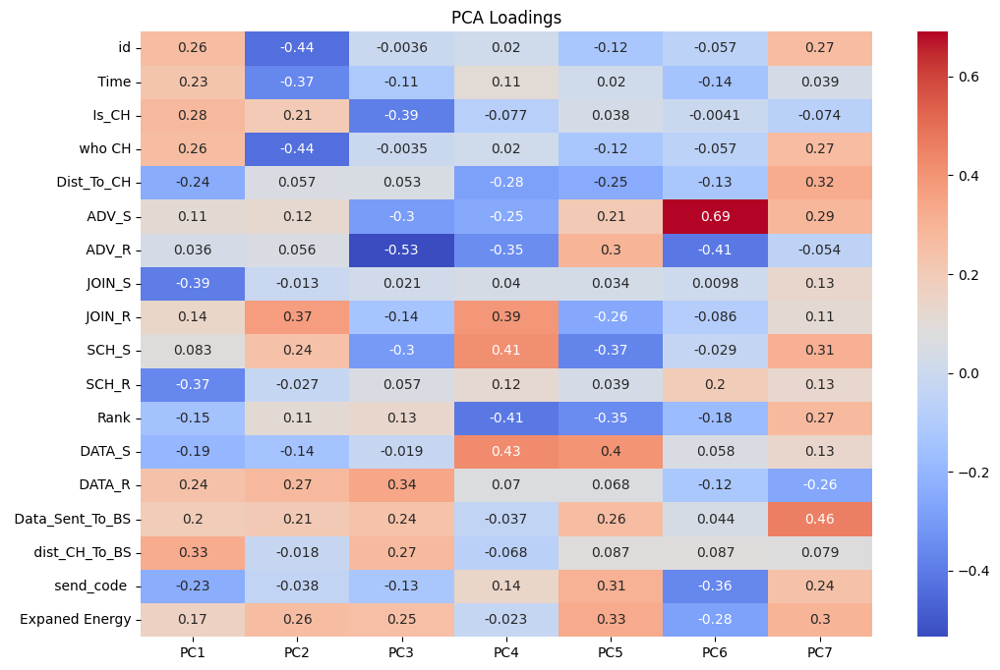

In [ ]:
import seaborn as sns
loadings = pd.DataFrame(model.components_.T, columns=[f'PC{i+1}' for i in range(n_pcs)], index=initial_feature_names)

plt.figure(figsize=(12, 8))
sns.heatmap(loadings, annot=True, cmap='coolwarm')
plt.title('PCA Loadings')
plt.show()


In [ ]:
req_df=df[most_important_names]
req_df.dtypes
req_float = req_df.astype(float)


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
#sns.pairplot(req_df[:50])


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


##visualising the top 6 columns in a parallel coordinates by taking 50 points in it

In [ ]:
import matplotlib.pyplot as plt
from matplotlib.path import Path
import matplotlib.patches as patches
import numpy as np
import random

In [ ]:
original_df=pd.read_csv("WSN-DS.csv")

In [ ]:
attack_type=original_df["Attack type"]
attack_type=pd.DataFrame(attack_type)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
tdma_indices=original_df.loc[original_df["Attack type"]=="TDMA"].index.tolist()
flood_indices=original_df.loc[original_df["Attack type"]=="Flooding"].index.tolist()
bhole_indices=original_df.loc[original_df["Attack type"]=="Blackhole"].index.tolist()
grhole_indices=original_df.loc[original_df["Attack type"]=="Grayhole"].index.tolist()
normal_indices=original_df.loc[original_df["Attack type"]=="Normal"].index.tolist()

In [ ]:
np.random.seed(42)
num_points=500
l=len(df)
print(f"l {l}")
points_per_category=num_points//5
flood_chunks=np.random.choice(flood_indices,points_per_category,replace=False)
tdma_chunks=np.random.choice(tdma_indices,points_per_category,replace=False)
bhole_chunks=np.random.choice(bhole_indices,points_per_category,replace=False)
grhole_chunks=np.random.choice(grhole_indices,points_per_category,replace=False)
normal_chunks=np.random.choice(normal_indices,points_per_category,replace=False)

random_indices=np.concatenate([flood_chunks,tdma_chunks,bhole_chunks,grhole_chunks,normal_chunks])


l 374661


In [ ]:
#choosing random 50 points to become one with the data
"""random_indices = np.random.choice(num_points, num_points, replace=False)
random_indices = np.random.choice(l, size=num_elements, replace=False)
random_indices = np.random.randint(1, num_points, size=l)
"""
ys=req_df.iloc[random_indices]
print(f"ys",ys)
category=original_df["Attack type"][random_indices].to_numpy()
ys=ys.to_numpy()


ys             id   JOIN_S   ADV_R   Data_Sent_To_BS   DATA_S   ADV_S
5737    201069        0      27                13        0       9
14110   304054        0      28                13        0      19
25703   302001        0      28                13        0       7
24880   106027        0      17               160        0      10
7053    602034        0      28                13        0      18
...        ...      ...     ...               ...      ...     ...
24447   101094        1      27                 0       22       0
280198  116025        1       6                 0       32       0
92054   303079        1       3                 0       51       0
96498   215016        1       4                 0       53       0
1182    112082        1       6                 0       51       0

[500 rows x 6 columns]


In [ ]:
num_points

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


500

In [ ]:
feat_no={"Normal":1,"TDMA":2,"Blackhole":3,"Grayhole":4,"Flooding":5}

In [ ]:
#normalising the data
ymins = ys.min(axis=0).astype(float)
ymaxs = ys.max(axis=0).astype(float)
dys = ymaxs - ymins
ymins -= dys * 0.05  # add 5% padding below and above
ymaxs += dys * 0.05
dys = ymaxs - ymins

# transform all data to be compatible with the main axis
zs = np.zeros_like(ys)
zs.shape

(500, 6)

In [ ]:
set(category)

{'Blackhole', 'Flooding', 'Grayhole', 'Normal', 'TDMA'}

In [ ]:
zs[:, 0] = ys[:, 0]
zs[:, 1:] = (ys[:, 1:] - ymins[1:]) / dys[1:] * dys[0] + ymins[0]

fig, host = plt.subplots(figsize=(20,8))

axes = [host] + [host.twinx() for i in range(ys.shape[1] - 1)]
for i, ax in enumerate(axes):
    ax.set_ylim(ymins[i], ymaxs[i])
    ax.spines['top'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    if ax != host:
        ax.spines['left'].set_visible(False)
        ax.yaxis.set_ticks_position('right')
        ax.spines["right"].set_position(("axes", i / (ys.shape[1] - 1)))
title="parallel coordination plot"
host.set_xlim(0, ys.shape[1] - 1)
host.set_xticks(range(ys.shape[1]))
host.set_xticklabels(most_important_names,fontsize=14)
host.tick_params(axis='x', which='major', pad=7)
host.spines['right'].set_visible(False)
host.xaxis.tick_top()
host.set_title('Parallel Coordinates Plot', fontsize=18)
host.set_xlim(0, ys.shape[1] - 1)
host.set_xticks(range(ys.shape[1]))
host.set_xticklabels(most_important_names, fontsize=14)
host.tick_params(axis='x', which='major', pad=7)
host.spines['right'].set_visible(False)
host.xaxis.tick_top()
host.set_title(title, fontsize=18)

legend_handles = [None for _ in category]

colors = plt.cm.tab10.colors
for j in range(0,num_points):
    # to just draw straight lines between the axes:
    #host.plot(range(ys.shape[1]), zs[j,:], c=colors[(dictionary[category[j]] - 1) % len(colors) ])

    # create bezier curves
    # for each axis, there will a control vertex at the point itself, one at 1/3rd towards the previous and one
    #   at one third towards the next axis; the first and last axis have one less control vertex
    # x-coordinate of the control vertices: at each integer (for the axes) and two inbetween
    # y-coordinate: repeat every point three times, except the first and last only twice
    verts = list(zip([x for x in np.linspace(0, len(ys) - 1, len(ys) * 3 - 2, endpoint=True)],np.repeat(zs[j, :], 3)[1:-1]))
    # for x,y in verts: host.plot(x, y, 'go') # to show the control points of the beziers
    codes = [Path.MOVETO] + [Path.CURVE4 for _ in range(len(verts) - 1)]
    path = Path(verts, codes)
    patch = patches.PathPatch(path, facecolor='none', lw=1, edgecolor=colors[feat_no[category[j]]-1])
    legend_handles[feat_no[category[j]]] = patch
    host.add_patch(patch)
host.legend( set(legend_handles),set(category),
            loc='lower center', bbox_to_anchor=(0.5, -0.18),
            ncol=len(category), fancybox=True, shadow=True)

plt.tight_layout()
plt.show()


##Creating the model for the data

In [ ]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv1D, MaxPooling1D, LSTM, Dropout, Dense,Reshape,Lambda,InputLayer
from sklearn.preprocessing import LabelEncoder, StandardScaler

In [ ]:
def create_model():
    model = Sequential([
        #tf.keras.layers.Reshape((18, 3), input_shape=input_shape+(3,)),
        #Input(shape=(19, 1)),
        #InputLayer(input_shape=(18, 1))
        Lambda(lambda x: tf.tile(x, [1, 1, 3]), input_shape=(18, 1)),
        Conv1D(filters=64, kernel_size=3, activation='relu', padding='same'),
        Conv1D(filters=64, kernel_size=3, activation='relu', padding='same'),
        MaxPooling1D(pool_size=2,strides=2, padding='same'),
        Conv1D(filters=128, kernel_size=3, activation='relu', padding='same'),
        Conv1D(filters=128, kernel_size=3, activation='relu', padding='same'),
        MaxPooling1D(pool_size=2,strides=2,padding='valid'),
        Conv1D(filters=256, kernel_size=3, activation='relu', padding='same'),
        Conv1D(filters=256, kernel_size=3, activation='relu', padding='same'),
        MaxPooling1D(pool_size=2,strides=2,padding='valid'),
        LSTM(70),
        Dropout(0.5),
        Dense(5, activation='softmax')
    ])
    model.compile(optimizer=tf.keras.optimizers.Adam(), loss=tf.keras.losses.CategoricalCrossentropy(), metrics=[tf.keras.metrics.CategoricalAccuracy(),tf.keras.metrics.Precision()],run_eagerly=True)
    return model

In [ ]:
model1=create_model()

In [ ]:
model1.summary()


In [ ]:
#model1.fit(X_train_reshaped,y_train,epochs=1,batch_size=1000,validation_data=(X_test_reshaped,y_test))

In [ ]:
#evaluation_result=model1.evaluate(X_test_reshaped,y_test)

In [ ]:
#evaluation_result[2]

In [ ]:
def divide_dataframe(df, num_clients):
    # Calculate the approximate size of each piece
    chunk_size = len(df) // num_clients
    chunks = []

    # Divide the DataFrame
    for i in range(num_clients):
        if i == num_clients - 1:
            # Last chunk includes all remaining rows
            chunk = df[i * chunk_size:]
        else:
            chunk = df[i * chunk_size: (i + 1) * chunk_size]
        chunks.append(chunk)

    return chunks
num_clients = 10

# Divide the DataFrame
X_train_chunks = divide_dataframe(X_train_reshaped, num_clients)
y_train_chunks=divide_dataframe(y_train,num_clients)
X_test_chunks=divide_dataframe(X_test_reshaped,num_clients)
y_test_chunks=divide_dataframe(y_test,num_clients)

In [ ]:
VERBOSE = 0
NUM_CLIENTS = 100
class FlowerClient(fl.client.NumPyClient):
    def __init__(self, X_train,y_train,X_test,y_test) -> None:
        # Create model
        self.model = create_model()
        self.X_train = X_train
        self.y_train=y_train
        self.X_test=X_test
        self.y_test=y_test

    def get_parameters(self, config):
        return self.model.get_weights()

    def fit(self, parameters, config):
        self.model.set_weights(parameters)
        self.model.fit(self.X_train,self.y_train, epochs=1)
        return self.model.get_weights(), len(self.X_train), {}

    def evaluate(self, parameters, config):
        self.model.set_weights(parameters)
        loss,acc,pre = self.model.evaluate(self.X_test,self.y_test)
        return loss, len(self.X_test), {"accuracy":acc ,"precision" :pre}

In [ ]:
def get_client_fn(X_train_chunks,y_train_chunks,X_test_chunks,y_test_chunks):
    """Return a function to construct a client.

    The VirtualClientEngine will execute this function whenever a client is sampled by
    the strategy to participate.
    """

    def client_fn(cid: str) -> fl.client.Client:
        """Construct a FlowerClient with its own dataset partition."""
        """client_dataset_splits = client_dataset.train_test_split(test_size=0.1, seed=42)

        trainset = client_dataset_splits["train"].to_tf_dataset(
            columns="image", label_cols="label", batch_size=32
        )
        valset = client_dataset_splits["test"].to_tf_dataset(
            columns="image", label_cols="label", batch_size=64
        )
        """
        X_train=X_train_chunks[int(cid)]
        y_train=y_train_chunks[int(cid)]
        X_test=X_test_chunks[int(cid)]
        y_test=y_test_chunks[int(cid)]
        return FlowerClient(X_train,y_train,X_test,y_test).to_client()

    return client_fn


def weighted_average(metrics: List[Tuple[int, Metrics]]) -> Metrics:
    # Multiply accuracy of each client by number of examples used
    accuracies = [num_examples * m["accuracy"] for num_examples, m in metrics]
    precisions=[num_examples * m["precision"] for num_examples, m in metrics]
    examples = [num_examples for num_examples, _ in metrics]

    # Aggregate and return custom metric (weighted average)
    return {"accuracy": sum(accuracies) / sum(examples),"precision :":sum(precisions)/sum(examples)}


def get_evaluate_fn(X_test,y_test):

    # The `evaluate` function will be called after every round by the strategy
    def evaluate(
        server_round: int,
        parameters: fl.common.NDArrays,
        config: Dict[str, fl.common.Scalar],
    ):
        model = create_model()  # Construct the model
        model.set_weights(parameters)  # Update model with the latest parameters
        loss,acc,pre = model.evaluate(X_test,y_test)
        return loss, {"accuracy": acc,"precision":pre}

    return evaluate

In [ ]:
# Enable GPU growth in your main process
#enable_tf_gpu_growth()

strategy = fl.server.strategy.FedAvg(
    fraction_fit=0.1,
    fraction_evaluate=0.05,
    min_fit_clients=2,
    min_evaluate_clients=1,
    min_available_clients=int(
        num_clients * 0.75
    ),
    evaluate_metrics_aggregation_fn=weighted_average,
    evaluate_fn=get_evaluate_fn(X_test_reshaped,y_test),
)

client_resources = {"num_cpus": 1, "num_gpus": 0.0}


In [ ]:
fl.common.logger.configure(identifier="myFlowerExperiment", filename="log.txt")


In [ ]:
history = fl.simulation.start_simulation(
    client_fn=get_client_fn(X_train_chunks,y_train_chunks,X_test_chunks,y_test_chunks),
    num_clients=num_clients,
    config=fl.server.ServerConfig(num_rounds=1),
    strategy=strategy,
    client_resources=client_resources,
    actor_kwargs={
        "on_actor_init_fn": enable_tf_gpu_growth
    },
)

## Implementing FedSgd


In [ ]:
#Fed SGD Client

class FlowerSgdClient(fl.client.NumPyClient):
    def __init__(self, X_train,y_train,X_test,y_test) -> None:
        # Create model
        self.model = create_model()
        self.X_train = X_train
        self.y_train=y_train
        self.X_test=X_test
        self.y_test=y_test

    def get_parameters(self, config):
        return self.model.get_weights()

    def fit(self, parameters, config):
        self.model.set_weights(parameters)
        self.model.fit(self.X_train,self.y_train, epochs=1)
        with tf.GradientTape() as tape:
            predictions = self.model(self.x_train, training=True)
            loss = tf.keras.losses.sparse_categorical_crossentropy(self.y_train, predictions)
        gradients = tape.gradient(loss, self.model.trainable_variables)
        gradients = [g.numpy() for g in gradients]

        return gradients, len(self.x_train),{}

    def evaluate(self, parameters, config):
        self.model.set_weights(parameters)
        loss,acc,pre = self.model.evaluate(self.X_test,self.y_test)
        return loss, len(self.X_test), {"accuracy":acc ,"precision" :pre}

In [ ]:
# Copyright 2020 Flower Labs GmbH. All Rights Reserved.
#
# Licensed under the Apache License, Version 2.0 (the "License");
# you may not use this file except in compliance with the License.
# You may obtain a copy of the License at
#
#     http://www.apache.org/licenses/LICENSE-2.0
#
# Unless required by applicable law or agreed to in writing, software
# distributed under the License is distributed on an "AS IS" BASIS,
# WITHOUT WARRANTIES OR CONDITIONS OF ANY KIND, either express or implied.
# See the License for the specific language governing permissions and
# limitations under the License.
# ==============================================================================
"""Federated Averaging (FedAvg) [McMahan et al., 2016] strategy.

Paper: arxiv.org/abs/1602.05629
"""


from logging import WARNING
from typing import Callable, Dict, List, Optional, Tuple, Union

from flwr.common import (
    EvaluateIns,
    EvaluateRes,
    FitIns,
    FitRes,
    MetricsAggregationFn,
    NDArrays,
    Parameters,
    Scalar,
    ndarrays_to_parameters,
    parameters_to_ndarrays,
)
from flwr.common.logger import log
from flwr.server.client_manager import ClientManager
from flwr.server.client_proxy import ClientProxy

from .aggregate import aggregate, aggregate_inplace, weighted_loss_avg
from .strategy import Strategy

WARNING_MIN_AVAILABLE_CLIENTS_TOO_LOW = """
Setting `min_available_clients` lower than `min_fit_clients` or
`min_evaluate_clients` can cause the server to fail when there are too few clients
connected to the server. `min_available_clients` must be set to a value larger
than or equal to the values of `min_fit_clients` and `min_evaluate_clients`.
"""


# pylint: disable=line-too-long
class FedAvg(Strategy):
    """Federated Averaging strategy.

    Implementation based on https://arxiv.org/abs/1602.05629

    Parameters
    ----------
    fraction_fit : float, optional
        Fraction of clients used during training. In case `min_fit_clients`
        is larger than `fraction_fit * available_clients`, `min_fit_clients`
        will still be sampled. Defaults to 1.0.
    fraction_evaluate : float, optional
        Fraction of clients used during validation. In case `min_evaluate_clients`
        is larger than `fraction_evaluate * available_clients`,
        `min_evaluate_clients` will still be sampled. Defaults to 1.0.
    min_fit_clients : int, optional
        Minimum number of clients used during training. Defaults to 2.
    min_evaluate_clients : int, optional
        Minimum number of clients used during validation. Defaults to 2.
    min_available_clients : int, optional
        Minimum number of total clients in the system. Defaults to 2.
    evaluate_fn : Optional[Callable[[int, NDArrays, Dict[str, Scalar]],Optional[Tuple[float, Dict[str, Scalar]]]]]
        Optional function used for validation. Defaults to None.
    on_fit_config_fn : Callable[[int], Dict[str, Scalar]], optional
        Function used to configure training. Defaults to None.
    on_evaluate_config_fn : Callable[[int], Dict[str, Scalar]], optional
        Function used to configure validation. Defaults to None.
    accept_failures : bool, optional
        Whether or not accept rounds containing failures. Defaults to True.
    initial_parameters : Parameters, optional
        Initial global model parameters.
    fit_metrics_aggregation_fn : Optional[MetricsAggregationFn]
        Metrics aggregation function, optional.
    evaluate_metrics_aggregation_fn : Optional[MetricsAggregationFn]
        Metrics aggregation function, optional.
    inplace : bool (default: True)
        Enable (True) or disable (False) in-place aggregation of model updates.
    """

    # pylint: disable=too-many-arguments,too-many-instance-attributes, line-too-long
    def __init__(
        self,
        *,
        fraction_fit: float = 1.0,
        fraction_evaluate: float = 1.0,
        min_fit_clients: int = 2,
        min_evaluate_clients: int = 2,
        min_available_clients: int = 2,
        evaluate_fn: Optional[
            Callable[
                [int, NDArrays, Dict[str, Scalar]],
                Optional[Tuple[float, Dict[str, Scalar]]],
            ]
        ] = None,
        on_fit_config_fn: Optional[Callable[[int], Dict[str, Scalar]]] = None,
        on_evaluate_config_fn: Optional[Callable[[int], Dict[str, Scalar]]] = None,
        accept_failures: bool = True,
        initial_parameters: Optional[Parameters] = None,
        fit_metrics_aggregation_fn: Optional[MetricsAggregationFn] = None,
        evaluate_metrics_aggregation_fn: Optional[MetricsAggregationFn] = None,
        inplace: bool = True,
    ) -> None:
        super().__init__()

        if (
            min_fit_clients > min_available_clients
            or min_evaluate_clients > min_available_clients
        ):
            log(WARNING, WARNING_MIN_AVAILABLE_CLIENTS_TOO_LOW)

        self.fraction_fit = fraction_fit
        self.fraction_evaluate = fraction_evaluate
        self.min_fit_clients = min_fit_clients
        self.min_evaluate_clients = min_evaluate_clients
        self.min_available_clients = min_available_clients
        self.evaluate_fn = evaluate_fn
        self.on_fit_config_fn = on_fit_config_fn
        self.on_evaluate_config_fn = on_evaluate_config_fn
        self.accept_failures = accept_failures
        self.initial_parameters = initial_parameters
        self.fit_metrics_aggregation_fn = fit_metrics_aggregation_fn
        self.evaluate_metrics_aggregation_fn = evaluate_metrics_aggregation_fn
        self.inplace = inplace

    def __repr__(self) -> str:
        """Compute a string representation of the strategy."""
        rep = f"FedAvg(accept_failures={self.accept_failures})"
        return rep

    def num_fit_clients(self, num_available_clients: int) -> Tuple[int, int]:
        """Return the sample size and the required number of available clients."""
        num_clients = int(num_available_clients * self.fraction_fit)
        return max(num_clients, self.min_fit_clients), self.min_available_clients

    def num_evaluation_clients(self, num_available_clients: int) -> Tuple[int, int]:
        """Use a fraction of available clients for evaluation."""
        num_clients = int(num_available_clients * self.fraction_evaluate)
        return max(num_clients, self.min_evaluate_clients), self.min_available_clients

    def initialize_parameters(
        self, client_manager: ClientManager
    ) -> Optional[Parameters]:
        """Initialize global model parameters."""
        initial_parameters = self.initial_parameters
        self.initial_parameters = None  # Don't keep initial parameters in memory
        return initial_parameters

    def evaluate(
        self, server_round: int, parameters: Parameters
    ) -> Optional[Tuple[float, Dict[str, Scalar]]]:
        """Evaluate model parameters using an evaluation function."""
        if self.evaluate_fn is None:
            # No evaluation function provided
            return None
        parameters_ndarrays = parameters_to_ndarrays(parameters)
        eval_res = self.evaluate_fn(server_round, parameters_ndarrays, {})
        if eval_res is None:
            return None
        loss, metrics = eval_res
        return loss, metrics

    def configure_fit(
        self, server_round: int, parameters: Parameters, client_manager: ClientManager
    ) -> List[Tuple[ClientProxy, FitIns]]:
        """Configure the next round of training."""
        config = {}
        if self.on_fit_config_fn is not None:
            # Custom fit config function provided
            config = self.on_fit_config_fn(server_round)
        fit_ins = FitIns(parameters, config)

        # Sample clients
        sample_size, min_num_clients = self.num_fit_clients(
            client_manager.num_available()
        )
        clients = client_manager.sample(
            num_clients=sample_size, min_num_clients=min_num_clients
        )

        # Return client/config pairs
        return [(client, fit_ins) for client in clients]

    def configure_evaluate(
        self, server_round: int, parameters: Parameters, client_manager: ClientManager
    ) -> List[Tuple[ClientProxy, EvaluateIns]]:
        """Configure the next round of evaluation."""
        # Do not configure federated evaluation if fraction eval is 0.
        if self.fraction_evaluate == 0.0:
            return []

        # Parameters and config
        config = {}
        if self.on_evaluate_config_fn is not None:
            # Custom evaluation config function provided
            config = self.on_evaluate_config_fn(server_round)
        evaluate_ins = EvaluateIns(parameters, config)

        # Sample clients
        sample_size, min_num_clients = self.num_evaluation_clients(
            client_manager.num_available()
        )
        clients = client_manager.sample(
            num_clients=sample_size, min_num_clients=min_num_clients
        )

        # Return client/config pairs
        return [(client, evaluate_ins) for client in clients]

    def aggregate_fit(
        self,
        server_round: int,
        results: List[Tuple[ClientProxy, FitRes]],
        failures: List[Union[Tuple[ClientProxy, FitRes], BaseException]],
    ) -> Tuple[Optional[Parameters], Dict[str, Scalar]]:
        """Aggregate fit results using weighted average."""
        if not results:
            return None, {}
        # Do not aggregate if there are failures and failures are not accepted
        if not self.accept_failures and failures:
            return None, {}

        if self.inplace:
            # Does in-place weighted average of results
            aggregated_ndarrays = aggregate_inplace(results)
        else:
            # Convert results
            weights_results = [
                (parameters_to_ndarrays(fit_res.parameters), fit_res.num_examples)
                for _, fit_res in results
            ]
            aggregated_ndarrays = aggregate(weights_results)

        parameters_aggregated = ndarrays_to_parameters(aggregated_ndarrays)

        # Aggregate custom metrics if aggregation fn was provided
        metrics_aggregated = {}
        if self.fit_metrics_aggregation_fn:
            fit_metrics = [(res.num_examples, res.metrics) for _, res in results]
            metrics_aggregated = self.fit_metrics_aggregation_fn(fit_metrics)
        elif server_round == 1:  # Only log this warning once
            log(WARNING, "No fit_metrics_aggregation_fn provided")

        return parameters_aggregated, metrics_aggregated

    def aggregate_evaluate(
        self,
        server_round: int,
        results: List[Tuple[ClientProxy, EvaluateRes]],
        failures: List[Union[Tuple[ClientProxy, EvaluateRes], BaseException]],
    ) -> Tuple[Optional[float], Dict[str, Scalar]]:
        """Aggregate evaluation losses using weighted average."""
        if not results:
            return None, {}
        # Do not aggregate if there are failures and failures are not accepted
        if not self.accept_failures and failures:
            return None, {}

        # Aggregate loss
        loss_aggregated = weighted_loss_avg(
            [
                (evaluate_res.num_examples, evaluate_res.loss)
                for _, evaluate_res in results
            ]
        )

        # Aggregate custom metrics if aggregation fn was provided
        metrics_aggregated = {}
        if self.evaluate_metrics_aggregation_fn:
            eval_metrics = [(res.num_examples, res.metrics) for _, res in results]
            metrics_aggregated = self.evaluate_metrics_aggregation_fn(eval_metrics)
        elif server_round == 1:  # Only log this warning once
            log(WARNING, "No evaluate_metrics_aggregation_fn provided")

        return loss_aggregated, metrics_aggregated

In [ ]:
"""        num_examples_total = sum(num_examples for _, num_examples, _ in results)

        # Aggregate the gradients
        aggregated_gradients = [
            np.sum([num_examples * grad[i] for grad, num_examples, _ in results], axis=0) / num_examples_total
            for i in range(len(results[0][0]))
        ]

        # Update the global model weights
        current_weights = self.parameters_to_ndarrays(self.current_parameters)
        updated_weights = [w - 0.01 * g for w, g in zip(current_weights, aggregated_gradients)]
        self.current_parameters = self.ndarrays_to_parameters(updated_weights)

        return self.current_parameters, {}"""

In [ ]:
class FedSgd(fl.server.strategy.FedAvg):
    def aggregate_fit(self,server_rounds,results,failures):
      #aggrgating the gradients
      total_num_examples=(num_examples for _,num_examples,_ in results)
      a
      """lst=grad for _,grad,_ in results
      aggregate_grad=sum(grad for _,grad,_ in results)"""
      num_examples_total = sum(num_examples for _, num_examples, _ in results)

        # Aggregate the gradients
      aggregated_gradients = [
            np.sum([num_examples * grad[i] for grad, num_examples, _ in results], axis=0) / num_examples_total
            for i in range(len(results[0][0]))
        ]

        # Update the global model weights
      current_weights = self.parameters_to_ndarrays(self.current_parameters)
      updated_weights = [w - 0.01 * g for w, g in zip(current_weights, aggregated_gradients)]
      self.current_parameters = self.ndarrays_to_parameters(updated_weights)
      print("the parameters is ",self.current_parameters)
      return self.current_parameters, {}
